<a href="https://colab.research.google.com/github/VishalShah1999/Visulization_ML/blob/main/vs2530_Vishal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Homework 4
## Dimensionality Reduction

In this homework, you will be using the [FIFA 2022 Dataset](https://drive.google.com/file/d/199NAatT2K0nxBWxRqh08xv0dmfFitSyv/view?usp=sharing), which is a `.csv` where each row is a player in the FIFA 2022 video game. Each player is described by a variety of attributes, like crossing ability, stamina, etc. Each attribute is described by a "grade". The data contains the 500 most valuable players in the game.

The list of attributes is `['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Dribbling', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Reactions', 'ShotPower', 'Stamina', 'Strength', 'LongShots', 'Aggression', 'Penalties', 'StandingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']`. Consider these the features. You will need to use these for PCA and t-SNE.

Start by uploading the `fifa.csv` to the notebook. Then run the code below, which downloads the player photos.

If there is code that requires a random seed (for example, t-SNE) please set it to `2022`.

In [ ]:
### DO NOT EDIT! ###

import pandas as pd
import requests
import time

from tqdm import tqdm

fifa = pd.read_csv("fifa.csv")  # Make sure you upload the csv

images = []
for i, row in tqdm(fifa.iterrows()):
     resp = requests.get(row["Photo"])
     with open(str(row["ID"]) + ".png", "wb") as f:
       f.write(resp.content)
     images.append("/content/" + str(row["ID"]) + ".png")

500it [00:39, 12.61it/s]


In [ ]:
import base64, io, IPython
from PIL import Image as PILImage

imgCode = []

for imgPath in images:
    image = PILImage.open(imgPath)
    output = io.BytesIO()    
    image.save(output, format='PNG')
    encoded_string = "data:image/png;base64,"+base64.b64encode(output.getvalue()).decode()
    imgCode.append(encoded_string)

fifa["image"] = imgCode

### Step 1: Preprocessing

Create a new variable, `Position`, and group the following positions (found in the `Best Position` feature) together:

LB, RB, LWB, RWB - Wing Back

RW, LW, RM, LM - Winger

CAM, CDM, CM - Central Midfielder

CF, ST - Striker

CB - Central Defender

GK - Goalkeeper

Below is a diagram of the soccer positions and their groupings.

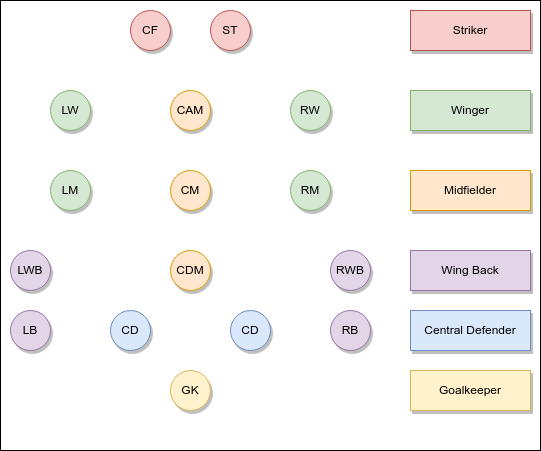

In [ ]:
def preprocessing(row):
    if row['Best Position'] == 'LB' or row['Best Position'] == 'RB' or row['Best Position'] == 'LWB' or row['Best Position'] == 'RWB':
        val = 'Wing Back'
    elif row['Best Position'] == 'RW' or row['Best Position'] == 'LW' or row['Best Position'] == 'RM' or row['Best Position'] == 'LM':
        val = 'Winger'
    elif row['Best Position'] == 'CAM' or row['Best Position'] == 'CDM' or row['Best Position'] == 'CM':
        val = 'Central Midfielder'
    elif row['Best Position'] == 'CF' or row['Best Position'] == 'ST':
        val = 'Striker'
    elif row['Best Position'] == 'CB':
        val = 'Central Defender'
    else:
        val = 'Goalkeeper'
    return val


In [ ]:
fifa['Position'] = fifa.apply(preprocessing, axis=1)

In [ ]:
fifa

,ID,Name,Photo,Value,Crossing,Finishing,HeadingAccuracy,ShortPassing,Dribbling,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Reactions,ShotPower,Stamina,Strength,LongShots,Aggression,Penalties,StandingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best Position,image,Position
0,239085,E. Haaland,https://cdn.sofifa.com/players/239/085/22_60.png,137500000,47.0,94.0,69.0,77.0,78.0,62.0,51.0,85.0,82.0,94.0,88.0,94.0,82.0,93.0,87.0,85.0,76.0,43.0,7.0,14.0,13.0,11.0,7.0,ST,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Striker
1,202126,H. Kane,https://cdn.sofifa.com/players/202/126/22_60.png,129500000,80.0,94.0,86.0,85.0,83.0,65.0,86.0,85.0,65.0,74.0,92.0,91.0,83.0,85.0,86.0,80.0,91.0,36.0,8.0,10.0,11.0,14.0,11.0,ST,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Striker
2,192985,K. De Bruyne,https://cdn.sofifa.com/players/192/985/22_60.png,125500000,94.0,82.0,55.0,94.0,88.0,83.0,93.0,91.0,76.0,76.0,91.0,91.0,89.0,74.0,91.0,76.0,83.0,65.0,15.0,13.0,5.0,10.0,13.0,CM,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Central Midfielder
3,188545,R. Lewandowski,https://cdn.sofifa.com/players/188/545/22_60.png,119500000,71.0,95.0,90.0,85.0,85.0,85.0,70.0,88.0,77.0,79.0,93.0,90.0,76.0,86.0,87.0,81.0,90.0,42.0,15.0,6.0,12.0,8.0,10.0,ST,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Striker
4,230621,G. Donnarumma,https://cdn.sofifa.com/players/230/621/22_60.png,119500000,12.0,12.0,12.0,36.0,28.0,14.0,34.0,30.0,50.0,55.0,85.0,59.0,34.0,72.0,18.0,30.0,24.0,14.0,91.0,83.0,79.0,85.0,90.0,GK,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Goalkeeper
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,216194,Dani García,https://cdn.sofifa.com/players/216/194/22_60.png,11500000,55.0,60.0,46.0,79.0,68.0,57.0,80.0,80.0,44.0,38.0,79.0,72.0,92.0,80.0,73.0,82.0,58.0,85.0,6.0,14.0,14.0,6.0,11.0,CDM,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Central Midfielder
496,213955,18 S. Azmoun,https://cdn.sofifa.com/players/213/955/18_60.png,11500000,64.0,76.0,84.0,67.0,73.0,50.0,63.0,74.0,79.0,79.0,74.0,73.0,65.0,72.0,72.0,67.0,55.0,33.0,6.0,10.0,14.0,9.0,15.0,ST,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Striker
497,225783,S. Mavididi,https://cdn.sofifa.com/players/225/783/22_60.png,11500000,69.0,75.0,70.0,71.0,79.0,42.0,66.0,74.0,88.0,89.0,69.0,73.0,70.0,74.0,70.0,45.0,59.0,18.0,6.0,10.0,6.0,8.0,16.0,ST,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Striker
498,253170,A. Szalai,https://cdn.sofifa.com/players/253/170/22_60.png,11500000,63.0,32.0,75.0,69.0,48.0,19.0,65.0,65.0,68.0,76.0,60.0,28.0,79.0,87.0,38.0,80.0,46.0,74.0,10.0,14.0,9.0,10.0,12.0,CB,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA...",Central Defender


### Step 2.1: PCA

Using the list of attributes above, reduce the dimensionality of the data using 2 principal components.

Plot the first and second components using `altair`. Color each point based on its grouping from Step 1, and make sure the tooltip for each point contains the player name, position and photo (use the `image` feature created in the first two code blocks).

What groupings of players are most directly visible?

In [ ]:
# code here
X = fifa[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Dribbling', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Reactions', 'ShotPower', 'Stamina', 'Strength', 'LongShots', 'Aggression', 'Penalties', 'StandingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']]

In [ ]:
from sklearn.decomposition import PCA
model_PCA = PCA(n_components=2)

In [ ]:
model_PCA.fit(X)

PCA(n_components=2)

In [ ]:
transformed_X = model_PCA.transform(X)

In [ ]:
transformed_X.shape

(500, 2)

In [ ]:
import altair as alt

In [ ]:
fifa['Component1'] = transformed_X[:,0]
fifa['Component2'] = transformed_X[:,1]

alt.Chart(...)
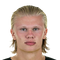
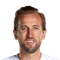
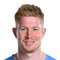
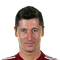
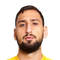
...
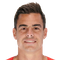
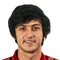
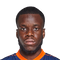
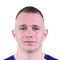
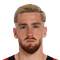

In [ ]:
cmap = {
    'Wing Back': '#0343df',
    'Winger': '#e50000',
    'Central Midfielder': '#ffff14',
    'Striker': '#929591',
    'Central Defender': '#33FCFF',
    'Goalkeeper': '#5601FF',
}

alt.Chart(fifa).mark_point(size=60).encode(
    x='Component1',
    y='Component2',
    color=alt.Color('Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

## It is all clear by looking at the scatter plot that grouping of GoalKeeper's are most directly visible than any other category.

### Step 2.2: PCA (no Goalkeepers)

Now, remove the goalkeepers from the data set, and re-run PCA. What does the first principal component seem to indicate (as you scan over the range of the 1st principal component, what relationship do you see?)

In [ ]:
# code here
df_withoutGK = fifa[fifa['Position'] != 'Goalkeeper']

In [ ]:
X_withoutGK = df_withoutGK[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Dribbling', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Reactions', 'ShotPower', 'Stamina', 'Strength', 'LongShots', 'Aggression', 'Penalties', 'StandingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']]

In [ ]:
withoutGK_PCA = PCA(n_components=2)

In [ ]:
withoutGK_PCA.fit(X_withoutGK)

PCA(n_components=2)

In [ ]:
transformed_withoutGK = withoutGK_PCA.transform(X_withoutGK)

In [ ]:
transformed_withoutGK.shape

(473, 2)

In [ ]:
df_withoutGK['Comp1_withoutGK'] = transformed_withoutGK[:,0]
df_withoutGK['Comp2_withoutGK'] = transformed_withoutGK[:,1]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


alt.Chart(...)
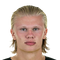
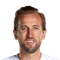
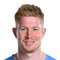
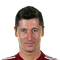
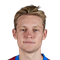
...
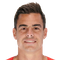
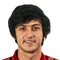
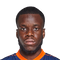
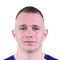
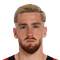

In [ ]:
cmap = {
    'Wing Back': '#0343df',
    'Winger': '#e50000',
    'Central Midfielder': '#ffff14',
    'Striker': '#929591',
    'Central Defender': '#33FCFF'
}

alt.Chart(df_withoutGK).mark_point(size=60).encode(
    x='Comp1_withoutGK',
    y='Comp2_withoutGK',
    color=alt.Color('Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

In [ ]:
print("Range With GoalKeeper : ", max(transformed_X[:,0]) - min(transformed_X[:,0]))

Range With GoalKeeper :  293.82493928839654


In [ ]:
range_withoutGK = max(transformed_withoutGK[:,0]) - min(transformed_withoutGK[:,0])
print("Range without GoalKeeper : ",range_withoutGK)

Range without GoalKeeper :  168.37569816559625


## From the range, we can say that data points of GoalKeeper's might consider as an outlier because it has a more wide range than any other attribute.

### Step 3.1: t-SNE

Using the t-SNE function from `sklearn`, create plot the results of using 2 components with the rest of the parameters set to the default. Set the random state to `2022`.

Be sure to plot in the same way as you did in 2.1 and 2.2 (using the same color indications, tooltips, etc.)

What relationships do you see in the t-SNE output?

In [ ]:
# code here
from sklearn.manifold import TSNE
X_tsne = TSNE(n_components=2, random_state=2022).fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [ ]:
fifa['Comp1_TSNE'] = X_tsne[:,0]
fifa['Comp2_TSNE'] = X_tsne[:,1]

alt.Chart(...)
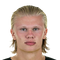
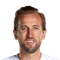
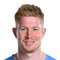
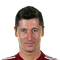
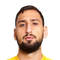
...
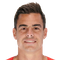
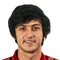
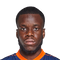
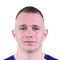
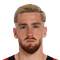

In [ ]:
cmap = {
    'Wing Back': '#0343df',
    'Winger': '#e50000',
    'Central Midfielder': '#ffff14',
    'Striker': '#929591',
    'Central Defender': '#33FCFF',
    'Goalkeeper': '#5601FF'
}

alt.Chart(fifa).mark_circle(size=60).encode(
    x='Comp1_TSNE',
    y='Comp2_TSNE',
    color=alt.Color('Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

## From the output of t-SNE we can say that all the clusters are clearly visible and distinguishable. GoalKeeper has it's separate range compare to all other attributes.

### Step 3.2: t-SNE (only central midfielders)

Now, do the same as above but only for central midfielders. This time, instead of indicating the broad position group in your chart (which would be "Midfielders" in this case), indicate the specific position through color, like "CAM", "CDM" and so on.

What relationships do you see in the t-SNE output?

In [ ]:
# code here
df_CM = fifa[fifa['Position'] == 'Central Midfielder']

In [ ]:
X_onlyCM = df_CM[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Dribbling', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Reactions', 'ShotPower', 'Stamina', 'Strength', 'LongShots', 'Aggression', 'Penalties', 'StandingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']]

In [ ]:
X_tsne_CM = TSNE(n_components=2, random_state=2022).fit_transform(X_onlyCM)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [ ]:
df_CM['Comp1_CentralMidfielders'] = X_tsne_CM[:,0]
df_CM['Comp2_CentralMidfielders'] = X_tsne_CM[:,1]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


alt.Chart(...)
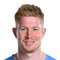
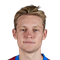
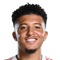
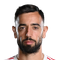
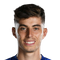
...
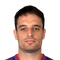
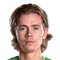
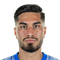
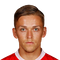
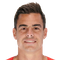

In [ ]:
cmap = {
    'CAM': '#0343df',
    'CDM': '#e50000',
    'CM': '#ffff14'
}

alt.Chart(df_CM).mark_point(size=60).encode(
    x='Comp1_CentralMidfielders',
    y='Comp2_CentralMidfielders',
    color=alt.Color('Best Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

## From the above graph we can say that Central Midfielder has very clear clusters and the attribute CAM is highly clustered as compare to other two.

### Step 3.3: t-SNE Parameters

Read [this Distill](https://distill.pub/2016/misread-tsne/) on t-SNE parameters.

The `perplexity` parameter is described in the Distill as

```"...which says (loosely) how to balance attention between local and global aspects of your data. The parameter is, in a sense, a guess about the number of close neighbors each point has."```

Create two plots, one where you select a perplexity such that the points appear more tightly clustered (many small, tight clusters), and another where they are less tightly clustered (larger, less clear clusters). The default perplexity is `30`, so consider this the baseline. Be sure to set the random seed to 2022 and use all of the data.

In [ ]:
# code here
X_tsne_perplexity_5 = TSNE(n_components=2, perplexity = 5, random_state=2022).fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [ ]:
fifa['Comp1_TSNE_perplex'] = X_tsne_perplexity_5[:,0]
fifa['Comp2_TSNE_perplex'] = X_tsne_perplexity_5[:,1]

alt.Chart(...)
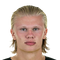
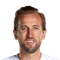
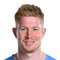
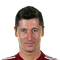
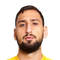
...
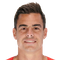
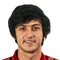
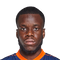
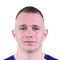
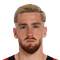

In [ ]:
cmap = {
    'Wing Back': '#0343df',
    'Winger': '#e50000',
    'Central Midfielder': '#ffff14',
    'Striker': '#929591',
    'Central Defender': '#33FCFF',
    'Goalkeeper': '#5601FF'
}

alt.Chart(fifa, title='Loosely clustered').mark_circle(size=60).encode(
    x='Comp1_TSNE_perplex',
    y='Comp2_TSNE_perplex',
    color=alt.Color('Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

In [ ]:
X_tsne_perplexity_50 = TSNE(n_components=2, perplexity = 50, random_state=2022).fit_transform(X)
fifa['Comp1_TSNE_perplex50'] = X_tsne_perplexity_50[:,0]
fifa['Comp2_TSNE_perplex50'] = X_tsne_perplexity_50[:,1]

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


alt.Chart(...)
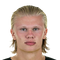
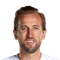
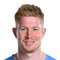
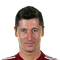
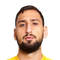
...
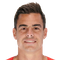
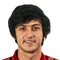
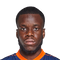
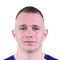
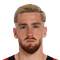

In [ ]:
cmap = {
    'Wing Back': '#0343df',
    'Winger': '#e50000',
    'Central Midfielder': '#ffff14',
    'Striker': '#929591',
    'Central Defender': '#33FCFF',
    'Goalkeeper': '#5601FF'
}

alt.Chart(fifa, title='Tightly clustered').mark_circle(size=60).encode(
    x='Comp1_TSNE_perplex50',
    y='Comp2_TSNE_perplex50',
    color=alt.Color('Position', scale=alt.Scale(domain=list(cmap.keys()), range=list(cmap.values()))),
    tooltip=['Name', 'Position', 'image']
)

### Step 3.4 t-SNE Questions

Answer the following questions:

(1) What do cluster sizes mean in t-SNE (e.g., one cluster with a large standard deviation vs. another with a tighter distribution)?

<b>Answer: </b> Cluster sizes doesn't mean anything remarkably.
<br><br>

(2) Do distances between clusters or points mean something?

<b>Answer: </b> No, we cannot get any insights from cluster sizes or intra-cluster distances.
<br><br>


(3) What are some advantages of t-SNE over PCA?

<b>Answer: </b> Complex relationships between features cannot be interpreted by PCA. t-SNE is best suited for nonlinear data. For both low and high dimensionality data, t-SNE tends to retain the global and local relationship.
<br><br>

(4) What are some disadvantages of t-SNE over PCA?

<b>Answer: </b>t-SNE has hyperparameters to be tuned unlike PCA. But it also has some disadvantages like same parameters produce different kind of results every time it gets run. So you won't get exact result everytime.
<br><br>